In [1]:
from PIL import Image, ImageDraw
from IPython.display import display
from tqdm.notebook import tqdm

In [2]:
insert_size = 128
border = 2

scenes = ['car', 'chess', 'dragon', 'sponza']
resolutions = ['12x140', '24x280', '36x420', '48x560']
methods = ['discrete', 'continuous', 'naive', 'interpolation']

depths = [[60, 25, 10],
          [85, 65, 30],
          [65, 45, 25],
          [80, 20, 0]]

coords = [[(355, 615), (567, 210), (770, 390)],
          [(473, 455), (660, 315), (300, 370)],
          [(350, 360), (535, 540), (540, 385)],
          [(75, 675), (440, 598), (490, 450)]]

colors = ['#2ca02c', '#1f77b4', '#ff7f0e']

n_scenes = len(scenes)
n_resolutions = len(resolutions)
n_methods = len(methods)
n_inserts = len(colors)

In [3]:
reference_img = []
reference_ins = []

with tqdm(total=n_scenes * n_inserts * n_inserts) as pbar:
    for scene_index in range(n_scenes):
        reference_img.append([])
        reference_ins.append([])
        for depth_index in range(n_inserts):
            with Image.open('figures/{}/reference/f{}-reference.png'.format(scenes[scene_index], depths[scene_index][depth_index])) as img:
                reference_img[scene_index].append(img)
                reference_ins[scene_index].append([])
                for insert_index in range(n_inserts):
                    x, y = coords[scene_index][insert_index]
                    insert = img.crop((x, y, x + insert_size, y + insert_size))
                    reference_ins[scene_index][depth_index].append(insert)

                    ImageDraw.Draw(img).rectangle((x, y, x + insert_size - 1, y + insert_size - 1), outline=colors[insert_index], width=border)
                    ImageDraw.Draw(insert).rectangle((0, 0, insert_size - 1, insert_size - 1), outline=colors[insert_index], width=border)
                    pbar.update()

                img.save('figures/inserts/{}-reference-{}.png'.format(scenes[scene_index], depth_index))

  0%|          | 0/36 [00:00<?, ?it/s]

In [4]:
methods_ins = []

with tqdm(total=n_scenes * n_resolutions * n_methods * n_inserts) as pbar:
    for scene_index in range(n_scenes):
        methods_ins.append([])
        for resolution_index in range(n_resolutions):
            methods_ins[scene_index].append([])
            for method_index in range(n_methods):
                methods_ins[scene_index][resolution_index].append([])
                for insert_index in range(n_inserts):
                    with Image.open('figures/{}/{}/f{}-{}.png'.format(scenes[scene_index], resolutions[resolution_index], depths[scene_index][insert_index], methods[method_index])) as img:
                        x, y = coords[scene_index][insert_index]
                        insert = img.crop((x, y, x + insert_size, y + insert_size))
                        methods_ins[scene_index][resolution_index][method_index].append(insert)

                        ImageDraw.Draw(insert).rectangle((0, 0, insert_size - 1, insert_size - 1), outline=colors[insert_index], width=border)
                        pbar.update()

  0%|          | 0/192 [00:00<?, ?it/s]

References with inserts
Columns: Near focus, Mid focus, Far focus


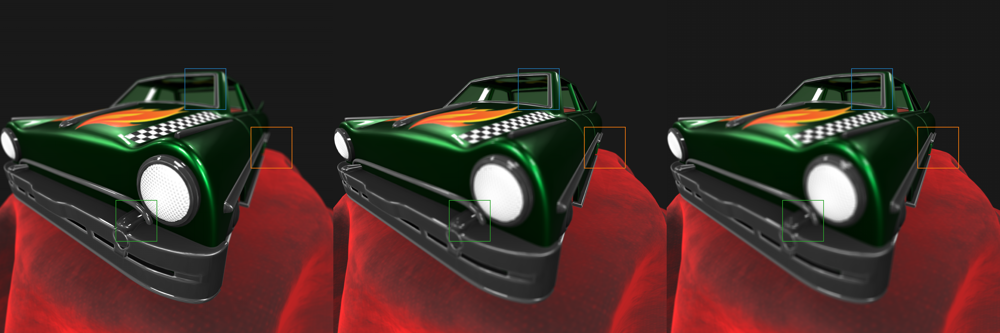

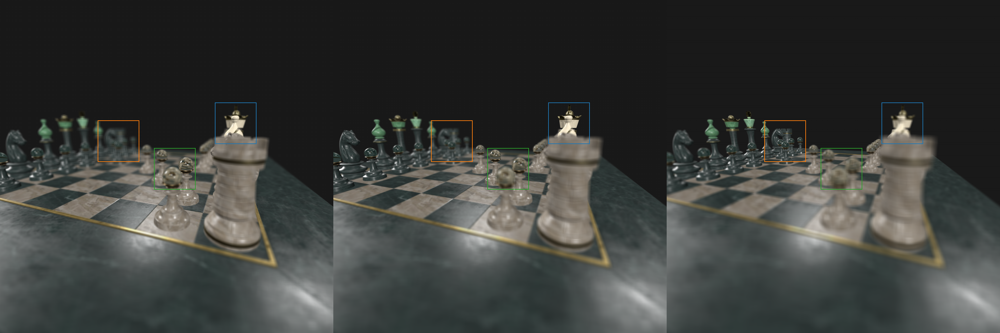

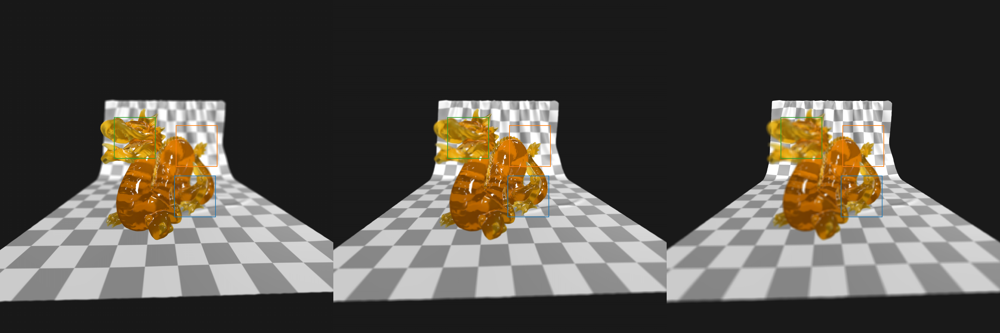

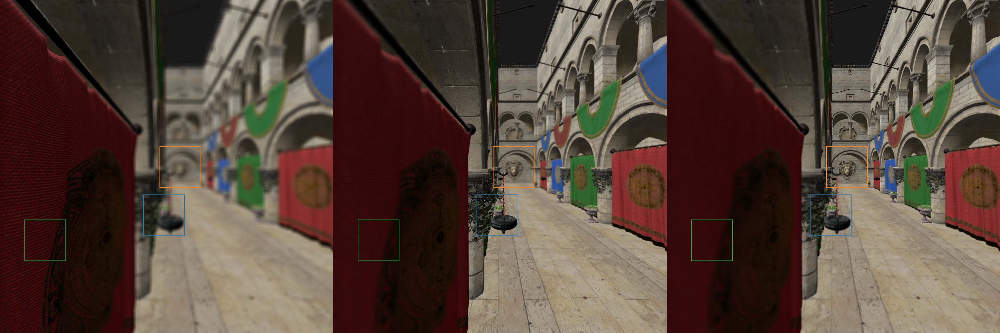

In [5]:
print('References with inserts')
print('Columns: Near focus, Mid focus, Far focus')

img = Image.new(mode='RGB', size=(3 * 1024, 1024), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for depth_index in range(n_inserts):
        img.paste(reference_img[scene_index][depth_index], (depth_index * 1024, 0))
    display(img)

Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation
Columns: Insert x Resolution


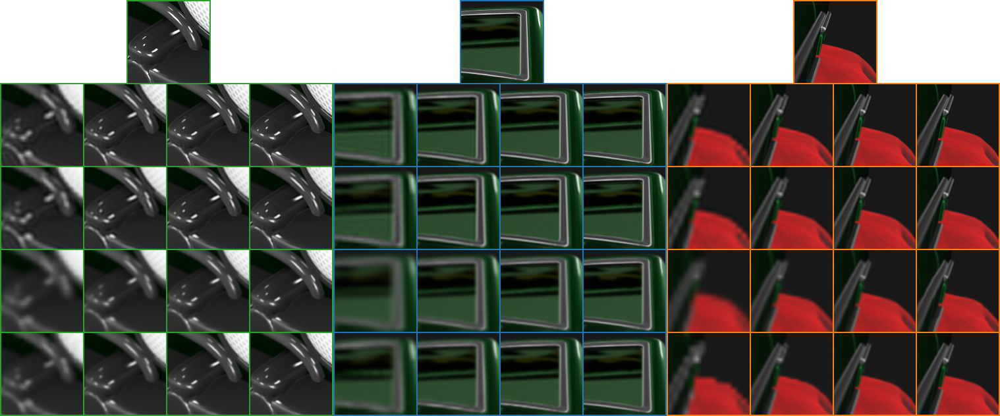

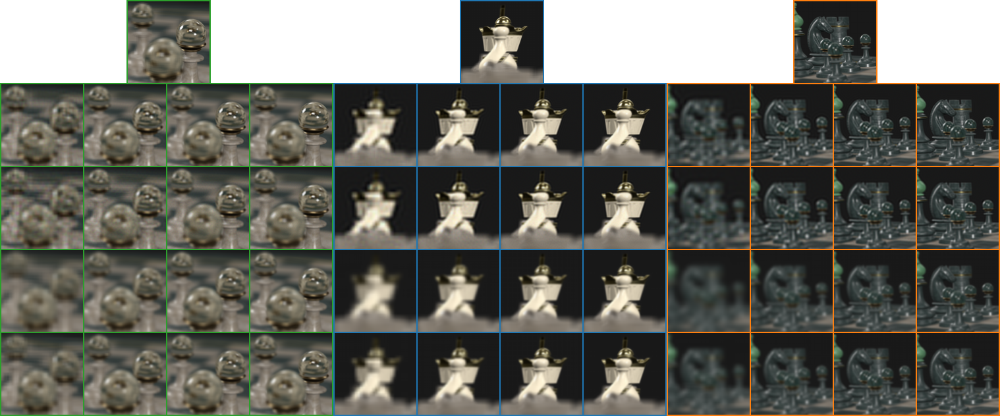

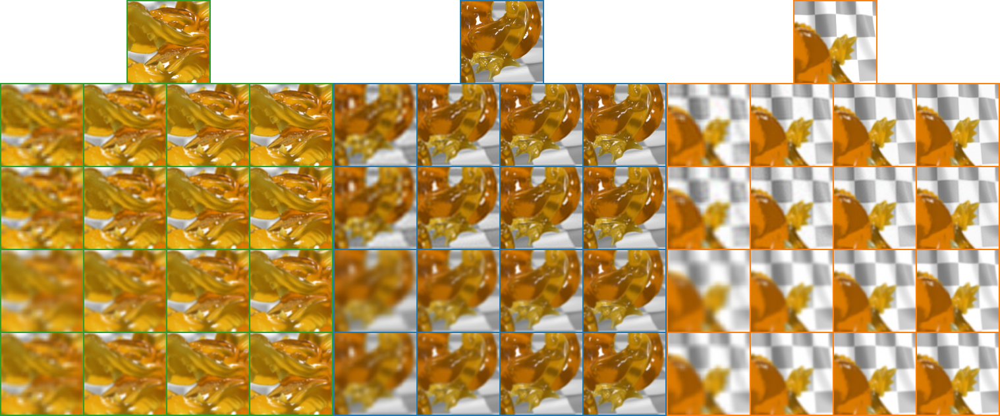

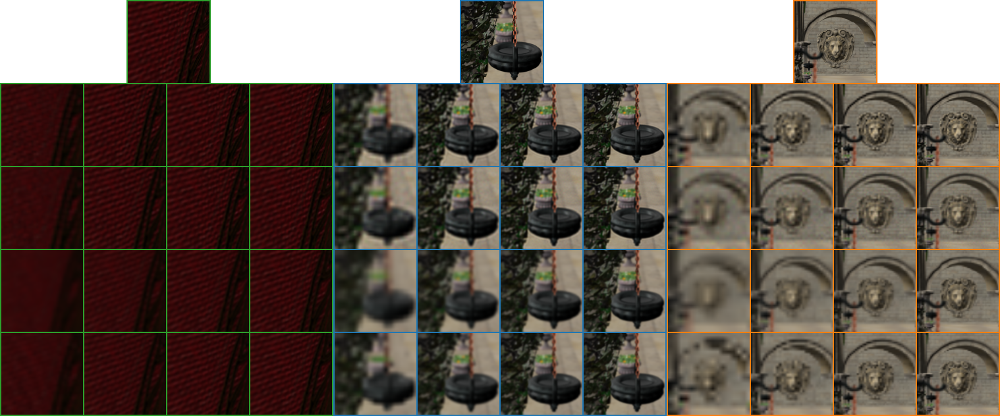

In [6]:
print('Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation')
print('Columns: Insert x Resolution')

img = Image.new(mode='RGB', size=(n_inserts * (n_resolutions * (insert_size-border) + border), (n_methods+1) * (insert_size-border) + border), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for insert_index in range(n_inserts):
        base_x = insert_index * (n_resolutions * (insert_size-border) + border)
        for resolution_index in range(n_resolutions):
            img.paste(reference_ins[scene_index][insert_index][insert_index], (base_x + insert_size + insert_size//2, 0))
            for method_index in range(n_methods):
                img.paste(methods_ins[scene_index][resolution_index][method_index][insert_index], (base_x + resolution_index * (insert_size-border), (method_index+1) * (insert_size-border)))
    img.save('figures/inserts/{}-inserts.png'.format(scenes[scene_index]))
    display(img)

Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation
Columns: Insert x Resolution


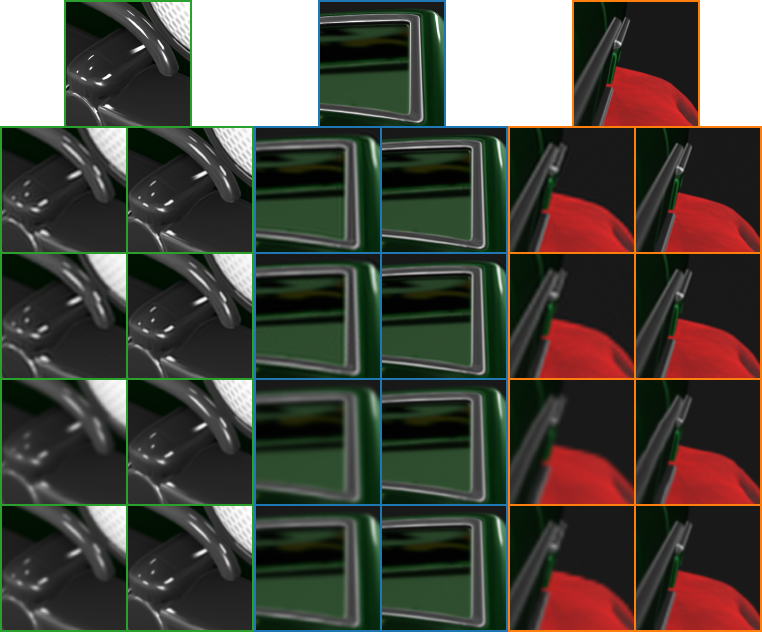

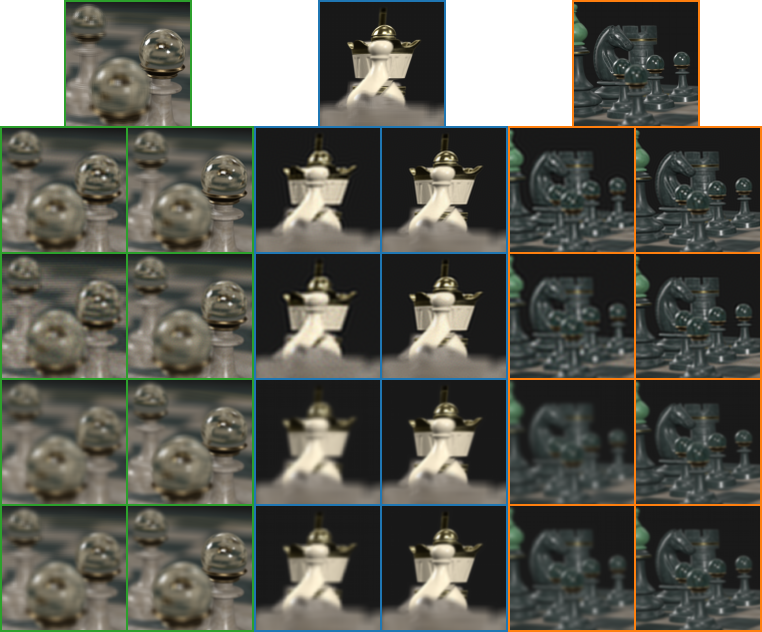

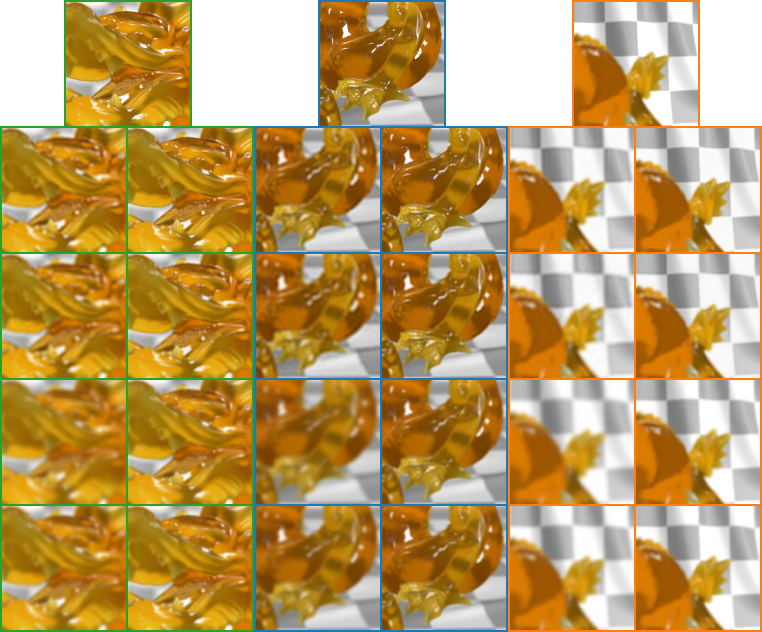

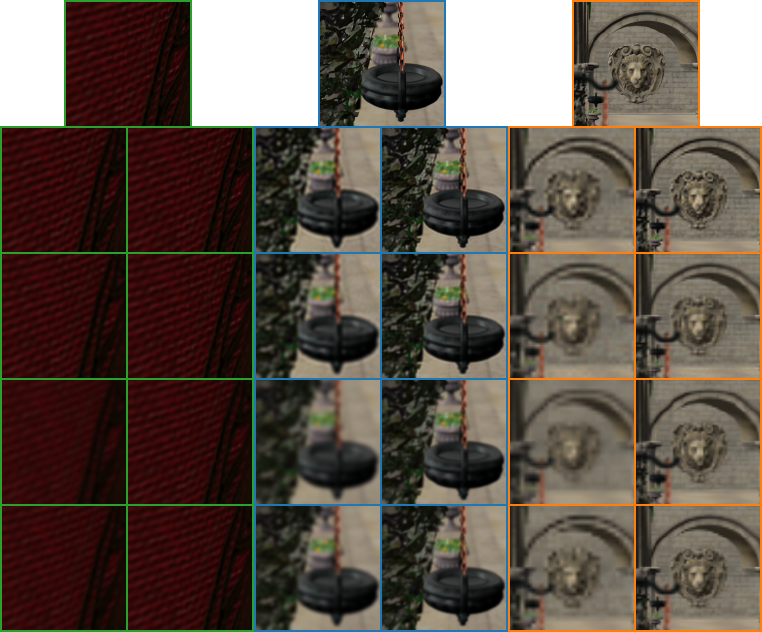

In [7]:
print('Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation')
print('Columns: Insert x Resolution')

img = Image.new(mode='RGB', size=(n_inserts * (2 * (insert_size-border) + border), (n_methods+1) * (insert_size-border) + border), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for insert_index in range(n_inserts):
        base_x = insert_index * (2 * (insert_size-border) + border)
        for resolution_index in range(2):
            img.paste(reference_ins[scene_index][insert_index][insert_index], (base_x + insert_size//2, 0))
            for method_index in range(n_methods):
                img.paste(methods_ins[scene_index][resolution_index*2 + 1][method_index][insert_index], (base_x + resolution_index * (insert_size-border), (method_index+1) * (insert_size-border)))
    img.save('figures/inserts/{}-inserts-half.png'.format(scenes[scene_index]))
    display(img)

Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation
Columns: Resolution


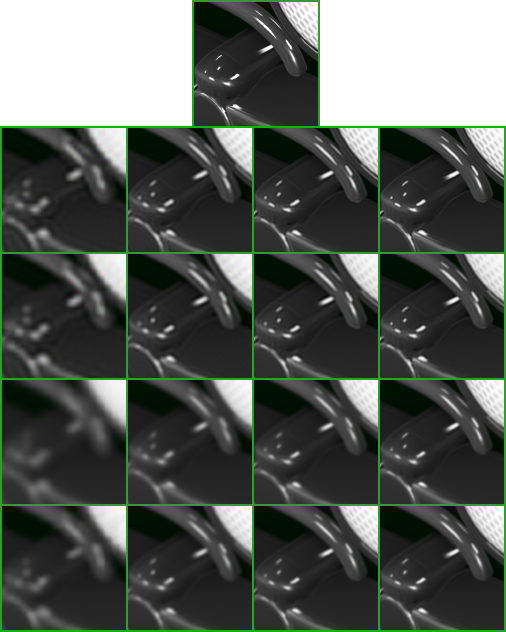

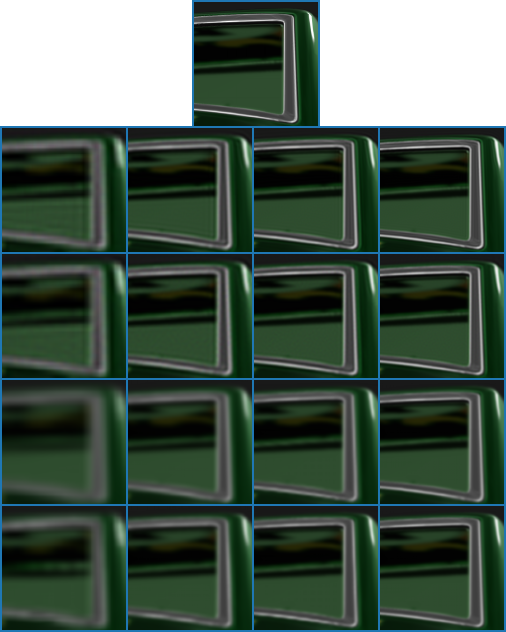

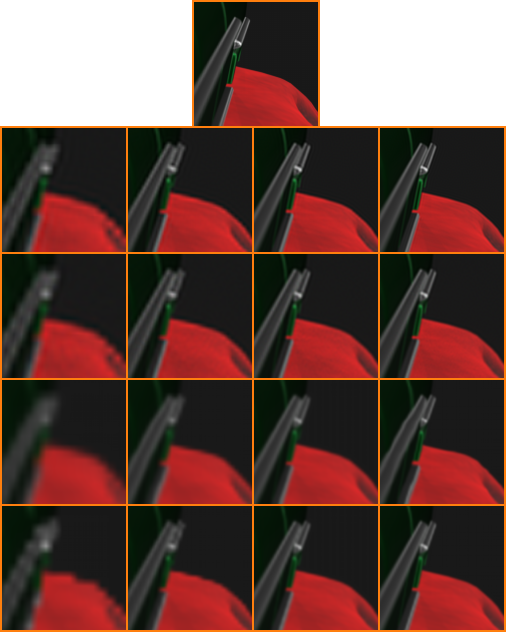

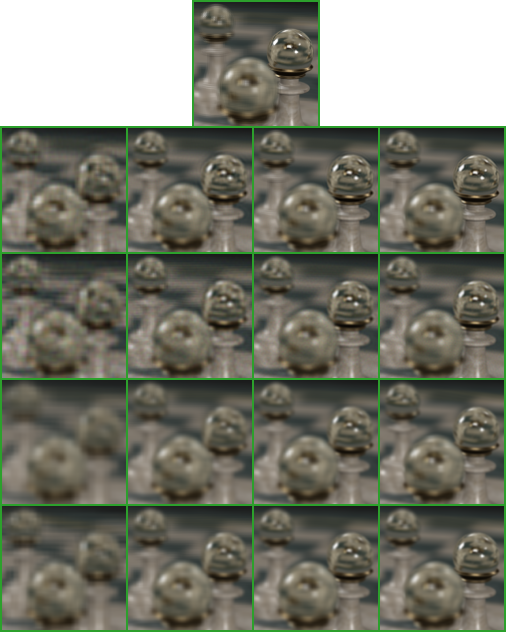

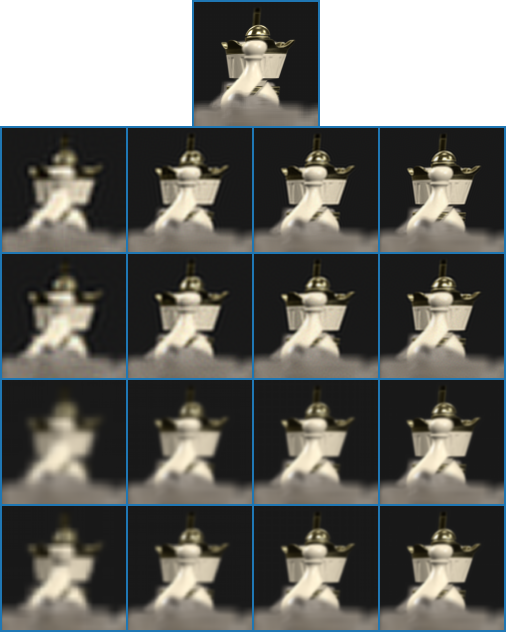

...

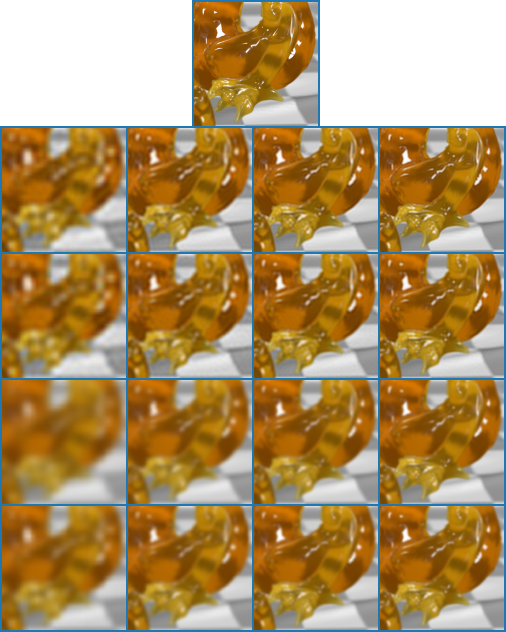

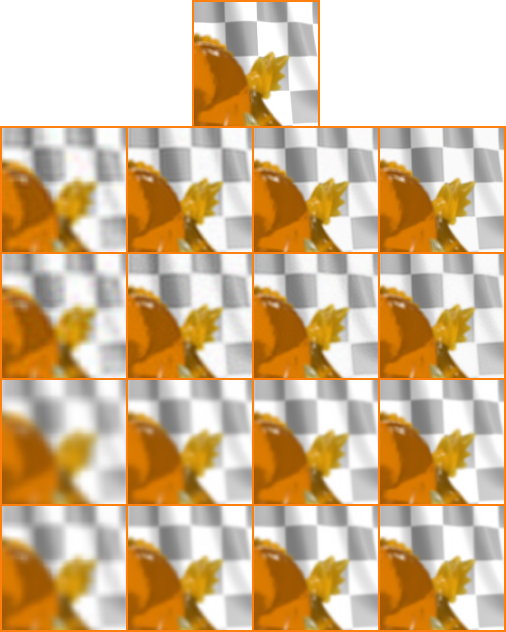

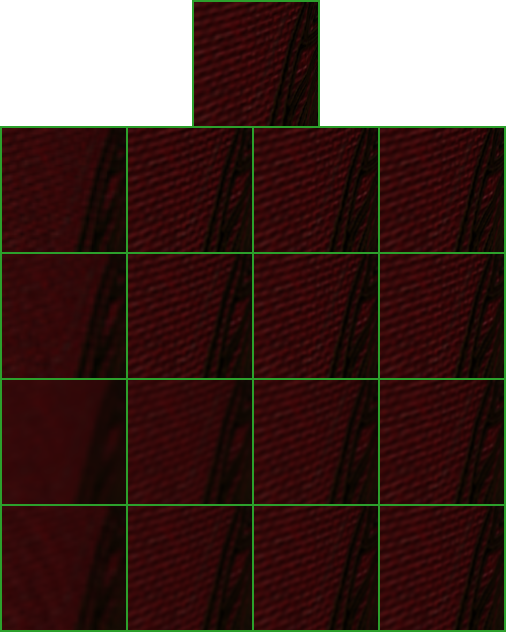

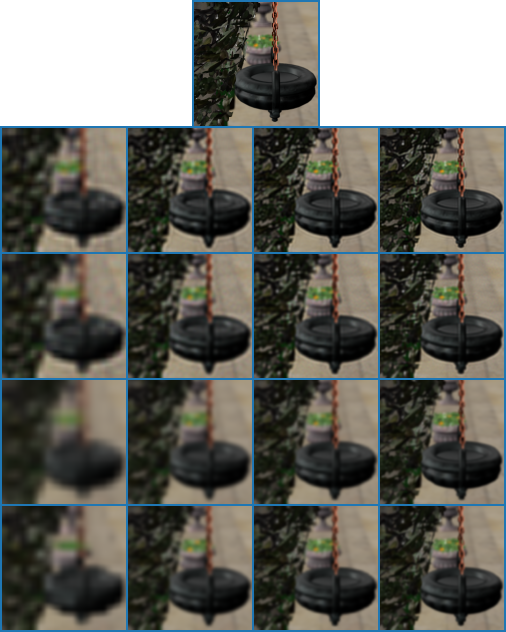

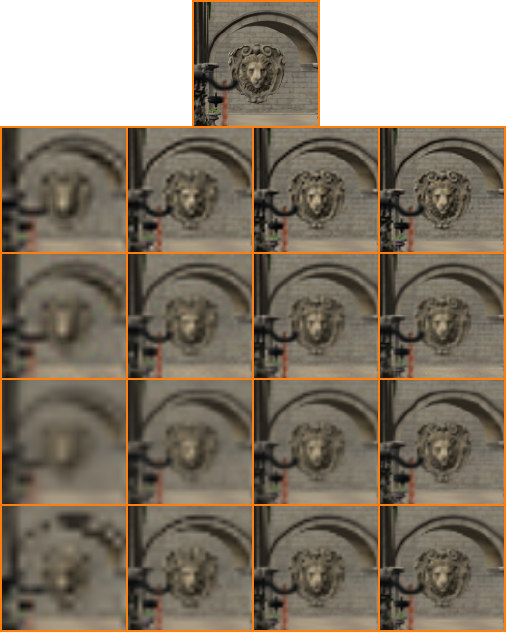

In [8]:
print('Rows: Reference, Retinal Pre-filtering (Known focus), Retinal Pre-filtering (Unknown focus), Display Pre-filtering, Interpolation')
print('Columns: Resolution')

img = Image.new(mode='RGB', size=(n_resolutions * (insert_size-border) + border, (n_methods+1) * (insert_size-border) + border), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for insert_index in range(n_inserts):
        for resolution_index in range(n_resolutions):
            img.paste(reference_ins[scene_index][insert_index][insert_index], (insert_size + insert_size//2, 0))
            for method_index in range(n_methods):
                img.paste(methods_ins[scene_index][resolution_index][method_index][insert_index], (resolution_index * (insert_size-border), (method_index+1) * (insert_size-border)))
        img.save('figures/inserts/{}-insert-{}.png'.format(scenes[scene_index], insert_index))
        display(img)

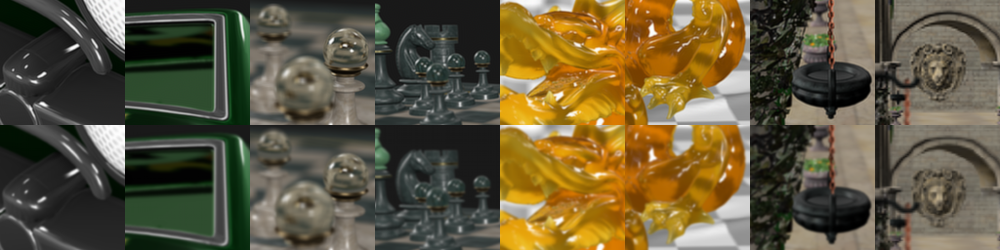

In [9]:
teaser = Image.new(mode='RGB', size=(8 * insert_size, 2 * insert_size))

selected_inserts = [0, 1, 0, 2, 0, 1, 1, 2]

for i in range(8):
    scene_index = i//2
    insert_index = selected_inserts[i]

    x, y = coords[scene_index][insert_index]

    with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
        teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (i * insert_size, insert_size))

    with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
        teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (i * insert_size, 0))
        
teaser.save('figures/inserts/teaser.png')
display(teaser)

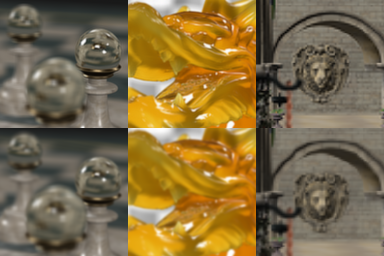

In [14]:
pseudo_teaser = Image.new(mode='RGB', size=(3 * insert_size, 2 * insert_size))

scene_index = 1
insert_index = 0

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (0, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (0, 0))

scene_index = 2
insert_index = 0

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (insert_size, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (insert_size, 0))

scene_index = 3
insert_index = 2

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (2 * insert_size, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    pseudo_teaser.paste(img.crop((x, y, x + insert_size, y + insert_size)), (2 * insert_size, 0))
        
pseudo_teaser.save('figures/inserts/pseudo-teaser.png')
display(pseudo_teaser)

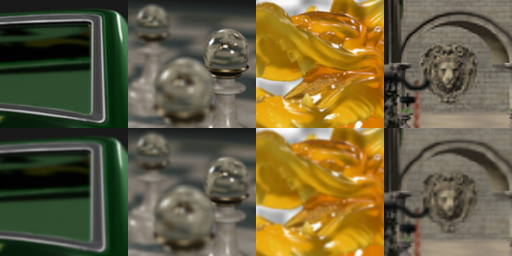

In [3]:
graphical_abstract = Image.new(mode='RGB', size=(4 * insert_size, 2 * insert_size))

scene_index = 0
insert_index = 1

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (0, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (0, 0))

scene_index = 1
insert_index = 0

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (insert_size, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (insert_size, 0))

scene_index = 2
insert_index = 0

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (2 * insert_size, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (2 * insert_size, 0))

scene_index = 3
insert_index = 2

x, y = coords[scene_index][insert_index]

with Image.open('figures/{}/48x560/f{}-naive.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (3 * insert_size, insert_size))

with Image.open('figures/{}/48x560/f{}-discrete.png'.format(scenes[scene_index], depths[scene_index][insert_index])) as img:
    graphical_abstract.paste(img.crop((x, y, x + insert_size, y + insert_size)), (3 * insert_size, 0))
        
graphical_abstract.save('figures/inserts/graphical-abstract.png')
display(graphical_abstract)